# Notebook for K-Means Clustering

### By Austin Houston

For AReMS, Spring 2025

[![Open in Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://github.com/AustinHouston/AReMS_2025/blob/main/1_KMeans.ipynb)

In [ ]:
# Install required libraries if not already present
!pip install -q gitpython

# Clone or pull the latest version of the repository
import os
from git import Repo

repo_url = 'https://github.com/<your_username>/<repository-name>.git'
repo_name = 'your-repo-name'  # replace with your repo name
import os
from pathlib import Path

if not os.path.exists(repo_name):
    from git import Repo
    Repo.clone_from(repo_url, repo_name)
else:
    repo = Repo(repo_name)
    origin = repo.remotes.origin
    origin.pull()

# Define the repository information
repo_url = "https://github.com/your-username/your-repo-name.git"
repo_name = "your-repo-name"  # replace with your repository folder name after cloning

import sys
import os
sys.path.append(f"/content/{repo_name}")

# OPTIONAL: Navigate into the repository folder
import os
os.chdir(repo_name)

print(f"Repository '{repo_name}' is ready in the Colab environment.")

In [1]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.colors as colors
import cv2
import os
%matplotlib ipympl
from mpl_toolkits.mplot3d import Axes3D

In [2]:
path_name = './images/'
files = []
for file in os.listdir(path_name):
    files = np.append(files,path_name + file)



The following clustered images look acceptable with n = 4.  Checker neyland looks best when a true green emerges in the histogram at n = 16, but it is the exception.  The reason higher n clusters produce 'fuzzy' images is essentially overfitting to noise.

In [10]:
# path = '/Users/austin/Documents/Grad School/CS425/homework_03/images/Unknown.jpeg'
path = '/Users/austin/Desktop/AReMS_2025/talk/K-Means jpegs/images/checkerneyland.jpeg'
files = []
files = np.append(files,path)

In [11]:
files

array(['/Users/austin/Desktop/AReMS_2025/talk/K-Means jpegs/images/checkerneyland.jpeg'],
      dtype='<U78')

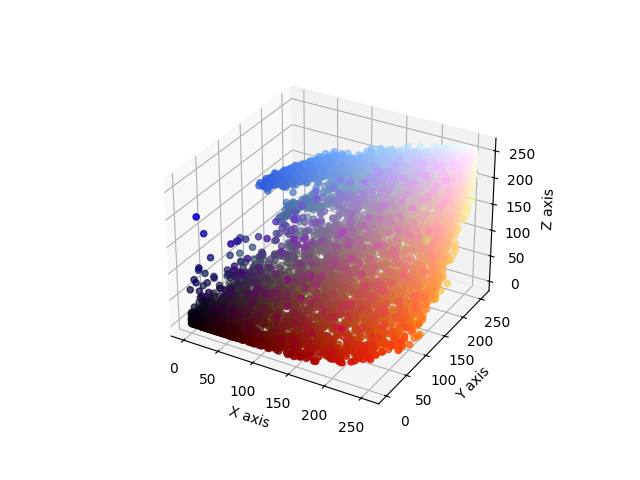

In [12]:

i = 0
image = cv2.imread(files[i])
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
im_data = np.ravel(image)
im_data = np.reshape(im_data,[int(len(im_data)/3),3])


# Set the fraction of data you want to plot (e.g., 1% of the points)
sparsity_factor = 0.01
num_points = int(len(im_data) * sparsity_factor)

# Randomly sample indices to plot a subset of the points
indices = np.random.choice(len(im_data), num_points, replace=False)

# Normalize the RGB values (assuming they're in the range [0, 255])
im_data_normalized = im_data / 255.0

# Create the figure and the 3D axis
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot only the selected points
ax.scatter(im_data[indices, 0], im_data[indices, 1], im_data[indices, 2], color=im_data_normalized[indices])

# Set labels
ax.set_xlabel('X axis')
ax.set_ylabel('Y axis')
ax.set_zlabel('Z axis')

plt.show()

In [13]:
def image_clustering(n_clusters, image, im_data, sparsity_factor=0.01):

    # Cluster fitting
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(im_data)

    # Extract RGB values of cluster centers
    r, g, b = kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], kmeans.cluster_centers_[:, 2]
    c_vals = list(zip(r / 255, g / 255, b / 255))

    # Histogram
    plt.figure()
    n, bins, patches = plt.hist(kmeans.labels_, bins=n_clusters, edgecolor='white')
    ticklabels = [i for i in range(n_clusters)]
    for bin in range(0, n_clusters):
        patches[bin].set_facecolor(c_vals[bin])
    plt.xlabel('bin number')
    plt.ylabel('pixel count')
    plt.title('histogram for n = ' + str(n_clusters))

    # Reshape the labels into the image shape to create the segmented image
    new_im = np.reshape(kmeans.labels_, [np.shape(image)[0], np.shape(image)[1]])
    my_cmap = colors.ListedColormap(c_vals)

    # Select a sparse subset of points
    num_points = int(len(im_data) * sparsity_factor)
    indices = np.random.choice(len(im_data), num_points, replace=False)

    # 3D Scatter plot of the clusters and cluster centers
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(111, projection='3d')

    # Scatter plot of the sparse data points colored by their assigned clusters
    point_colors = np.array([c_vals[label] for label in kmeans.labels_])
    ax.scatter(im_data[indices, 0], im_data[indices, 1], im_data[indices, 2], 
               color=point_colors[indices], marker='o', alpha=0.5)

    # Scatter plot of cluster centers (plot all cluster centers, no sparsity here)
    ax.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], kmeans.cluster_centers_[:, 2],
               color=c_vals, s=300, marker='x', edgecolor='black', label='Cluster Centers')

    # Set labels
    ax.set_xlabel('Red')
    ax.set_ylabel('Green')
    ax.set_zlabel('Blue')
    plt.title(f'3D scatter plot of clusters for {n_clusters} clusters (Sparse Plot)')
    plt.legend()
    plt.show()

    return new_im, my_cmap

def plot_images(i):
    # plotting
    fig, axs = plt.subplots(2, 2, figsize=(15, 10), dpi=300)

    # load original image
    image = cv2.imread(files[i])
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    im_data = np.ravel(image)
    im_data = np.reshape(im_data, [int(len(im_data)/3), 3])

    axs[0, 0].imshow(image)
    axs[0, 0].set_title('original ' + files[i].split('/')[-1])
    axs[0, 0].axis('off')

    new_im, my_cmap = image_clustering(4, image, im_data)
    axs[1, 0].imshow(new_im, cmap=my_cmap)
    axs[1, 0].set_title('n color centers = 4')
    axs[1, 0].axis('off')

    new_im, my_cmap = image_clustering(6, image, im_data)
    axs[0, 1].imshow(new_im, cmap=my_cmap)
    axs[0, 1].set_title('n color centers = 6')
    axs[0, 1].axis('off')

    new_im, my_cmap = image_clustering(100, image, im_data)
    axs[1, 1].imshow(new_im, cmap=my_cmap)
    axs[1, 1].set_title('n color centers =100')
    axs[1, 1].axis('off')

/var/folders/1h/36qxtl8567zdjv8nzdn4fzrr0000gn/T/ipykernel_62155/4043608220.py:39: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  ax.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], kmeans.cluster_centers_[:, 2],


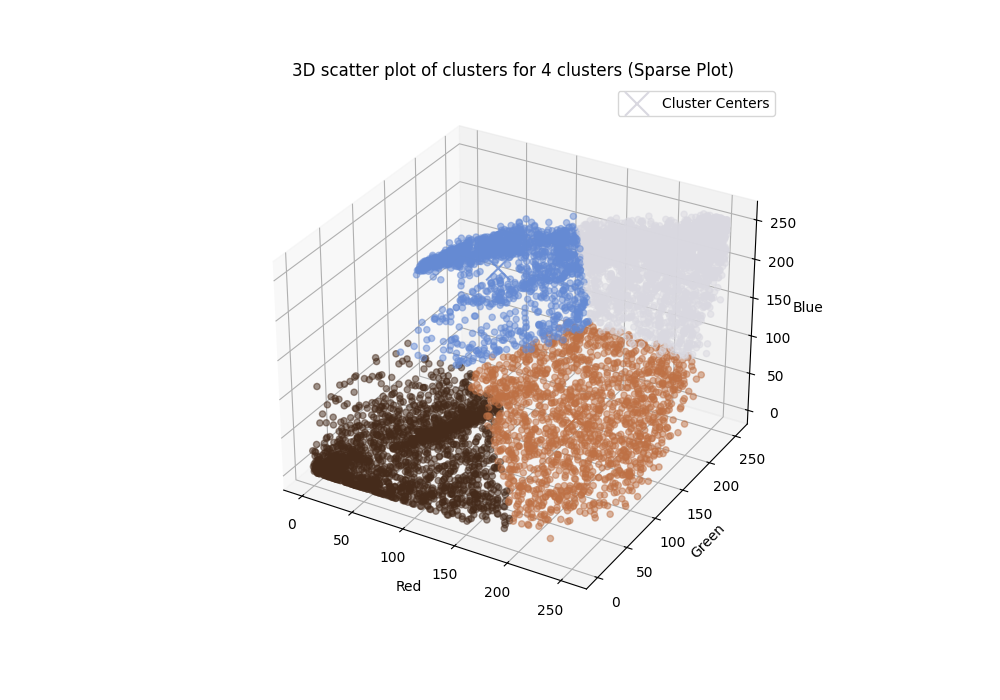

/var/folders/1h/36qxtl8567zdjv8nzdn4fzrr0000gn/T/ipykernel_62155/4043608220.py:39: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  ax.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], kmeans.cluster_centers_[:, 2],


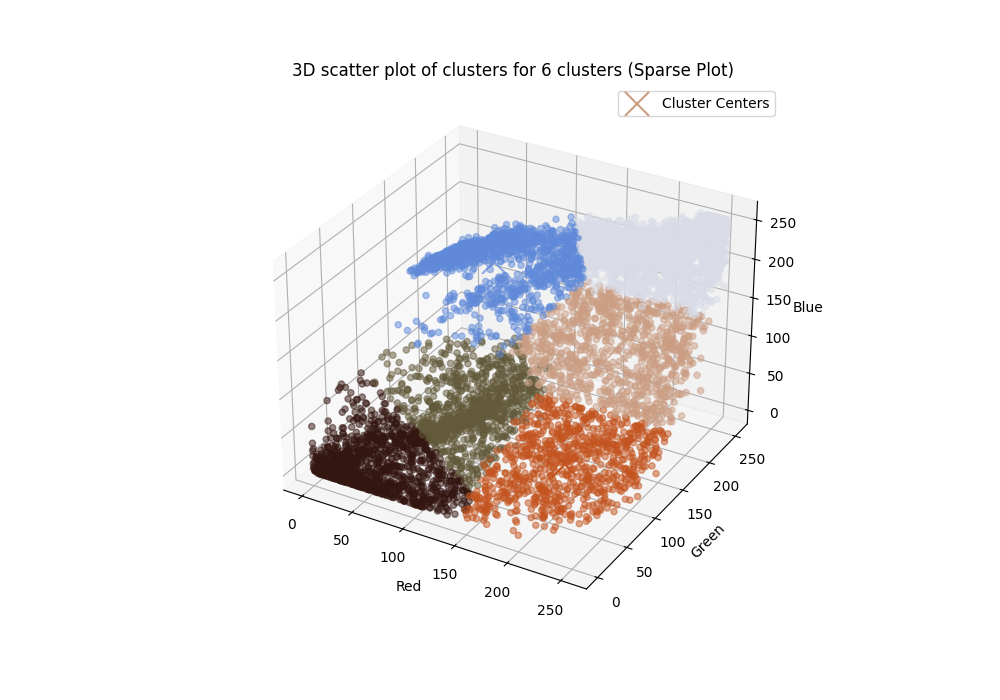

/var/folders/1h/36qxtl8567zdjv8nzdn4fzrr0000gn/T/ipykernel_62155/4043608220.py:39: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  ax.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], kmeans.cluster_centers_[:, 2],


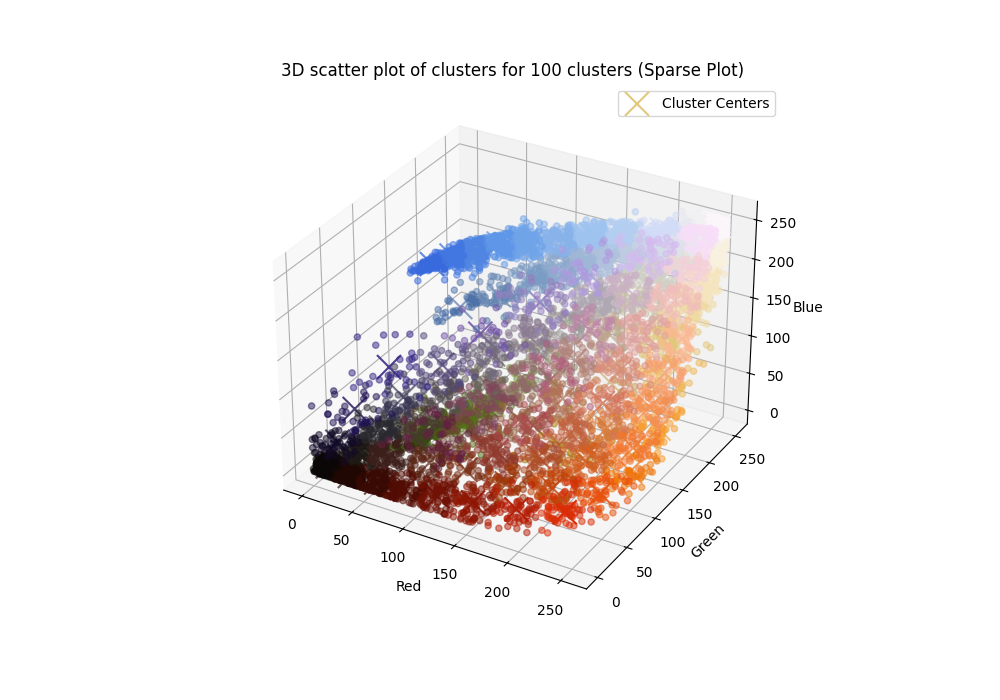

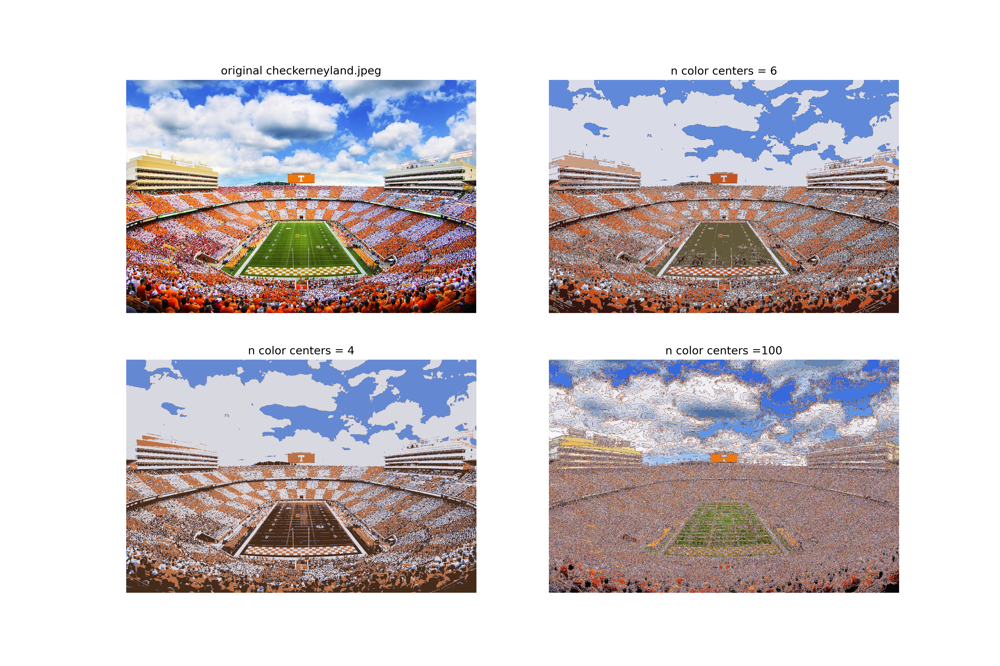

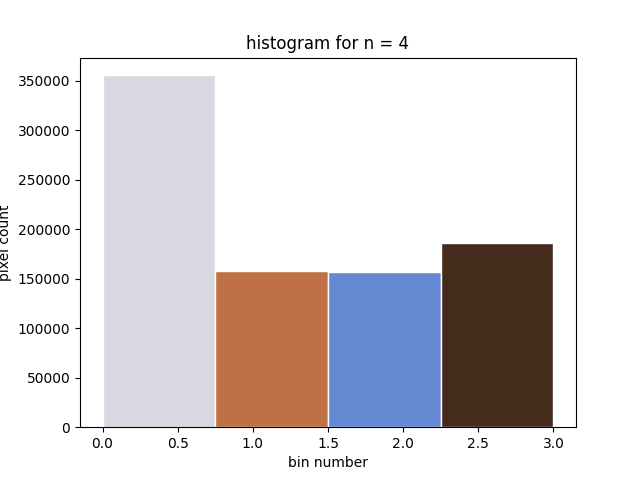

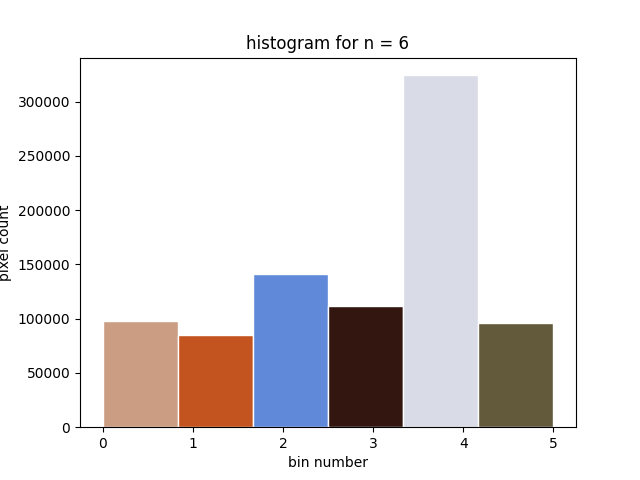

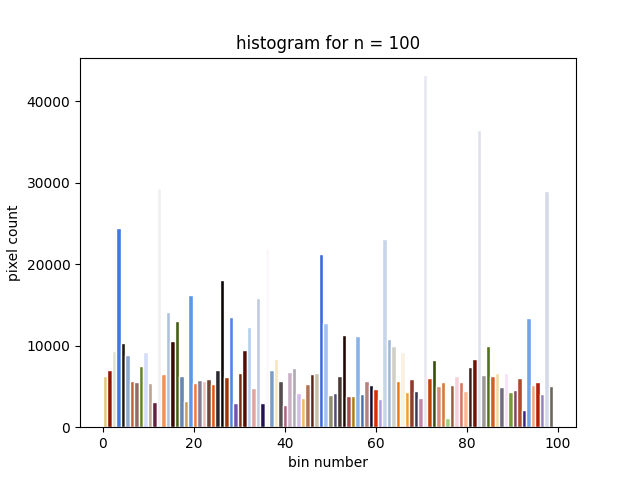

In [14]:
for i in range(len(files)):
    plot_images(i)

    